In [1]:
import torch
import torch.nn.functional as F
import torch.optim as optim
from torchvision import models, transforms
from torchvision.models import ResNet18_Weights
from PIL import Image
from tqdm.auto import tqdm

import numpy as np

import lovely_tensors as lt
lt.monkey_patch()

from pathlib import Path
Path.ls = lambda x: list(x.iterdir())

In [2]:
device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")

model = models.resnet18(weights=ResNet18_Weights.IMAGENET1K_V1)
model.eval()
model = model.to(device)

transform = ResNet18_Weights.IMAGENET1K_V1.transforms()

In [3]:
images_dir = Path('../data/example_images')
len(images_dir.ls())

50

tensor[1, 3, 224, 224] n=150528 (0.6Mb) x∈[-1.947, 2.570] μ=-0.114 σ=0.534 cuda:0


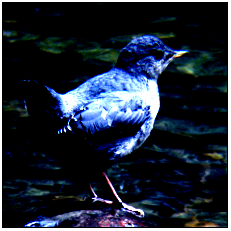

In [4]:
image = Image.open(images_dir.ls()[0])
t_image = transform(image).to(device)
batch = t_image.unsqueeze(0)
print(batch)
batch.rgb

In [5]:
import torch

means = torch.tensor([0.485, 0.456, 0.406]).to(device)
stds = torch.tensor([0.229, 0.224, 0.225]).to(device)

def norm(batch):
    return (batch - means.view(1, -1, 1, 1)) / stds.view(1, -1, 1, 1)

def denorm(batch):
    return batch * stds.view(1, -1, 1, 1) + means.view(1, -1, 1, 1)

def get_class_conf(model, batch):
    with torch.inference_mode():
        output = F.softmax(model(batch), dim=1)
        res_class_id = torch.argmax(output, 1)
        res_conf = output.gather(1, res_class_id[..., None])

        return res_class_id[0].item(), res_conf[0][0].item()


ref_class_id, ref_conf = get_class_conf(model, batch)
print(f"Started class was: {ref_class_id}, with confidence: {ref_conf:.6f}")

Started class was: 20, with confidence: 0.998181


  0%|          | 0/1000 [00:00<?, ?it/s]

Epsilon: 0.000700


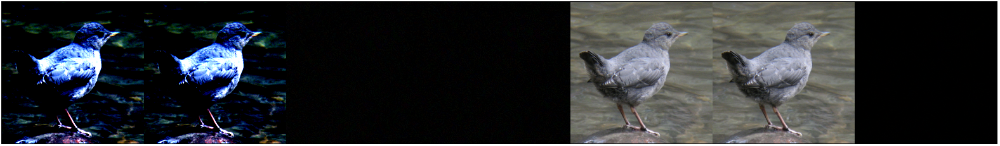

Started class was: 20, with confidence: 0.998181
Resulted class after adversarial noise: 0, with confidence: 0.988338


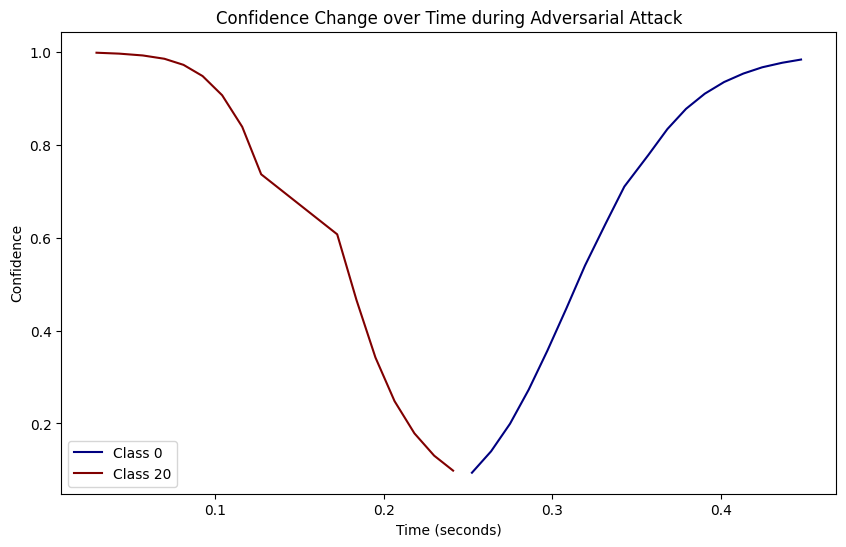

In [71]:
import torch
import torch.nn.functional as F
from tqdm.auto import tqdm
import time
import matplotlib.pyplot as plt

def fgsm_attack(image, epsilon, data_grad):
    sign_data_grad = data_grad.sign()
    perturbed_image = image + epsilon * sign_data_grad
    return perturbed_image

def attack(model, input_image, target_class, epsilon=0.007, num_iterations=1000, lambda_reg=0.05, verbose=True, stop_criteria=0.5):
    # Initialize the noise variable with zeros having the shape of a single image in the batch.
    # We then expand this noise to match the input batch size when applying it to each image.
    single_image_shape = list(input_image.shape)
    single_image_shape[0] = 1  # Set batch size to 1
    noise = torch.zeros(single_image_shape, device=input_image.device).requires_grad_(True)

    B = input_image.shape[0]
    target_tensor = torch.tensor([target_class]*B, dtype=torch.long, device=input_image.device)

    metrics = []
    start_time = time.time()

    progress = list(range(num_iterations))
    if verbose: 
        progress = tqdm(progress)
        print(f"Epsilon: {epsilon:.6f}")
    
    for _ in progress:
        model.zero_grad()

        # Repeat the noise for each image in the batch and add it to the input images
        repeated_noise = noise.repeat(B, 1, 1, 1)  # Repeat the noise pattern to match the batch size
        perturbed_image = input_image + repeated_noise

        output = model(perturbed_image)
        loss_adv = -F.cross_entropy(output, target_tensor)
        
        # Regularize the repeated noise instead of the perturbed image
        # Use the repeated noise for regularization to correctly accumulate gradients
        loss_reg = lambda_reg * F.mse_loss(repeated_noise, torch.zeros_like(repeated_noise))
        loss = loss_adv + loss_reg

        loss.backward()

        # Apply FGSM attack on the noise, considering the gradient with respect to the repeated noise
        noise_grad = noise.grad.data.mean(dim=0, keepdim=True)  # Average gradients over the batch
        noise.data = fgsm_attack(noise.data, epsilon, noise_grad)
        noise.grad.data.zero_()  # Clear gradients after updating

        if verbose and B == 1:
            res_class_id, res_conf = get_class_conf(model, perturbed_image)
            current_time = time.time() - start_time

            metrics.append({'time': current_time, 'confidence': res_conf, 'class_id': res_class_id})

            if res_class_id == target_class and res_conf >= stop_criteria:
                break
                
            progress.set_description(f"Loss ce: {loss_adv.item():.6f}, loss mse: {loss_reg.item():.6f}, predicted class: {res_class_id}, conf: {res_conf:.6f}")
        else:
            progress.set_description(f"Loss ce: {loss_adv.item():.6f}, loss mse: {loss_reg.item():.6f}")
            
        
    # Return the perturbed images and metrics, applying the final noise pattern to each input image.
    return input_image + noise.repeat(B, 1, 1, 1).detach(), metrics, noise.detach()


def plot_metrics(metrics):
    unique_classes = list(set([m['class_id'] for m in metrics]))
    # Create a color map for the classes
    colors = plt.cm.jet(np.linspace(0, 1, len(unique_classes)))
    class_to_color = {cls: colors[i] for i, cls in enumerate(unique_classes)}
    
    plt.figure(figsize=(10, 6))
    
    for cls in unique_classes:
        class_times = [m['time'] for m in metrics if m['class_id'] == cls]
        class_confidences = [m['confidence'] for m in metrics if m['class_id'] == cls]
        plt.plot(class_times, class_confidences, label=f'Class {cls}', color=class_to_color[cls])
    
    plt.xlabel('Time (seconds)')
    plt.ylabel('Confidence')
    plt.title('Confidence Change over Time during Adversarial Attack')
    plt.legend()
    plt.show()

in_b = batch[:1]

adv_example, metrics, noise = attack(model, in_b, 0, epsilon=0.0007, num_iterations=1000, lambda_reg=0.05, stop_criteria=0.98)

bdiff = in_b - adv_example
adiff = adv_example - in_b

display(torch.cat([in_b, adv_example, bdiff, adiff, denorm(adv_example), denorm(in_b), denorm(adv_example) - denorm(in_b)], dim=3).rgb)

ref_class_id, ref_conf = get_class_conf(model, in_b)
print(f"Started class was: {ref_class_id}, with confidence: {ref_conf:.6f}")

res_class_id, res_conf = get_class_conf(model, adv_example)
print(f"Resulted class after adversarial noise: {res_class_id}, with confidence: {res_conf:.6f}")

plot_metrics(metrics)

# Inference on multiple images

In [33]:
examples = []
for i in tqdm(images_dir.ls()):
    image = Image.open(i)
    in_b = transform(image).unsqueeze(0).to(device)
    adv_example, _, _ = attack(model, in_b, 0, epsilon=0.007, num_iterations=10000, lambda_reg=0.05, stop_criteria=0.95, verbose=False)
    ref_class_id, ref_conf = get_class_conf(model, in_b)
    res_class_id, res_conf = get_class_conf(model, adv_example)
    
    examples.append({
        "tensor": adv_example,
        "ref_class_id": ref_class_id,
        "ref_conf": ref_conf,
        "res_class_id": res_class_id,
        "res_conf": res_conf,
    })

  0%|          | 0/50 [00:00<?, ?it/s]

In [34]:
from collections import Counter
Counter([i['res_class_id'] for i in examples])

Counter({0: 50})

(array([ 1.,  0.,  3.,  2.,  2.,  1.,  3.,  4.,  9., 25.]),
 array([0.98661906, 0.98795578, 0.9892925 , 0.99062923, 0.99196595,
        0.99330267, 0.9946394 , 0.99597612, 0.99731284, 0.99864957,
        0.99998629]),
 <BarContainer object of 10 artists>)

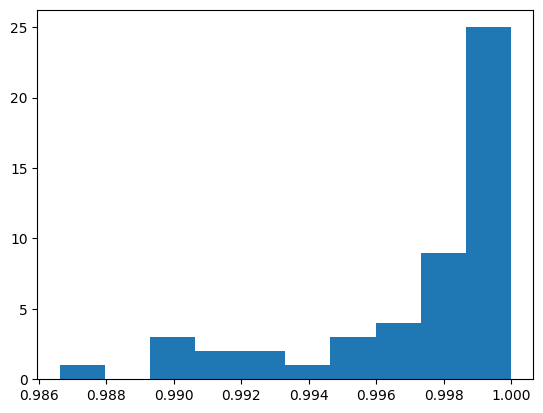

In [35]:
import matplotlib.pyplot as plt
confidences = [i['res_conf'] for i in examples]
plt.hist(confidences)

We can control confidence that we want to achieve. The price for high confidence is time.

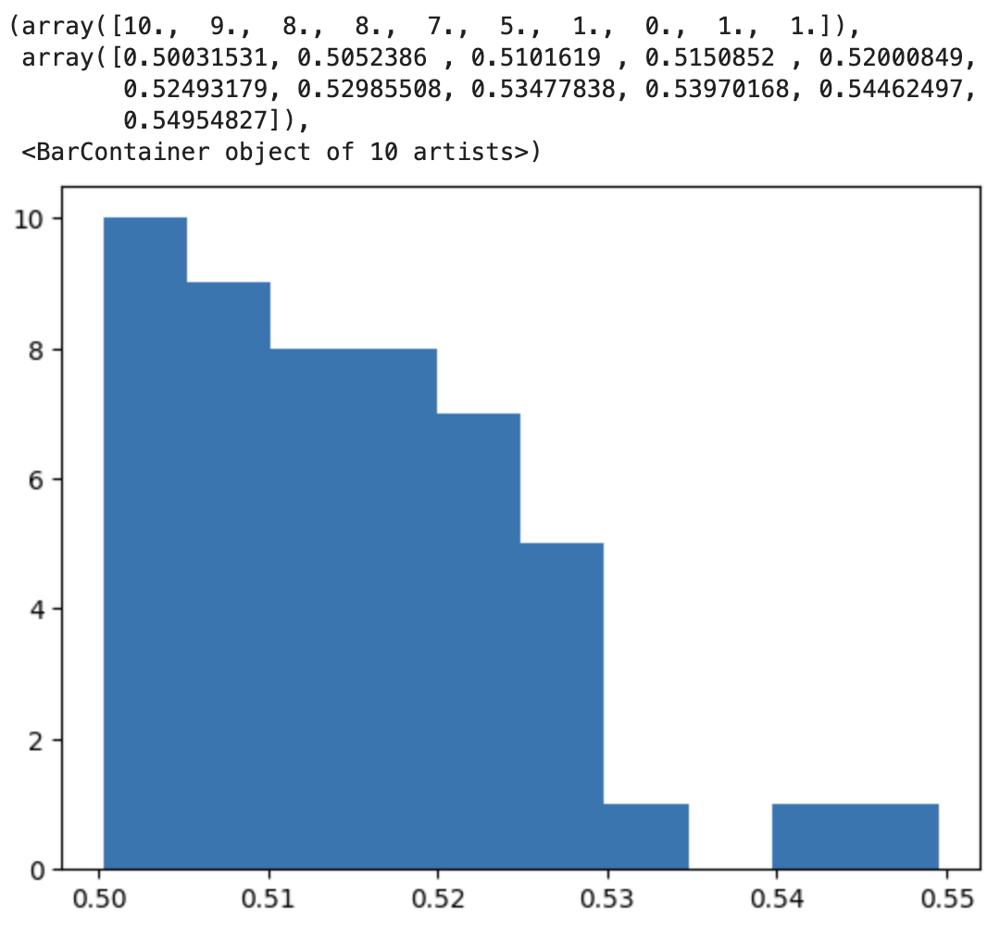

  0%|          | 0/1000 [00:00<?, ?it/s]

Epsilon: 0.000070


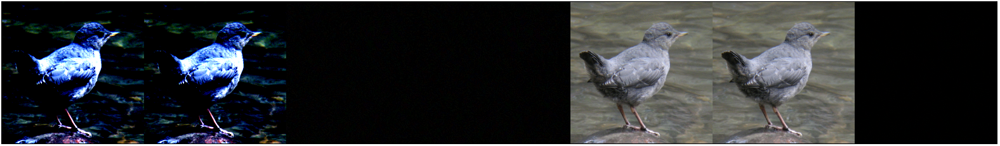

Started class was: 20, with confidence: 0.998181
Resulted class after adversarial noise: 0, with confidence: 0.981421


In [75]:
in_b = batch[:1]

adv_example, metrics, noise = attack(model, in_b, 0, epsilon=0.00007, num_iterations=1000, lambda_reg=100, stop_criteria=0.98)

bdiff = in_b - adv_example
adiff = adv_example - in_b

display(torch.cat([in_b, adv_example, bdiff, adiff, denorm(adv_example), denorm(in_b), denorm(adv_example) - denorm(in_b)], dim=3).rgb)

ref_class_id, ref_conf = get_class_conf(model, in_b)
print(f"Started class was: {ref_class_id}, with confidence: {ref_conf:.6f}")

res_class_id, res_conf = get_class_conf(model, adv_example)
print(f"Resulted class after adversarial noise: {res_class_id}, with confidence: {res_conf:.6f}")

Started class was: 842, with confidence: 0.838838
Resulted class after adversarial noise: 842, with confidence: 0.834105


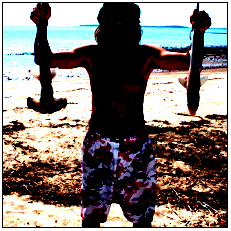

In [76]:
i = 7
image = Image.open(images_dir.ls()[i])
in_b = transform(image).unsqueeze(0).to(device)

ref_class_id, ref_conf = get_class_conf(model, in_b)
print(f"Started class was: {ref_class_id}, with confidence: {ref_conf:.6f}")

res_class_id, res_conf = get_class_conf(model, in_b + noise)
print(f"Resulted class after adversarial noise: {res_class_id}, with confidence: {res_conf:.6f}")

in_b.rgb

In [94]:
b_size = 20

batch = []
for i in range(b_size):
    image = Image.open(images_dir.ls()[i])
    in_b = transform(image).unsqueeze(0).to(device)
    batch.append(in_b)
batch = torch.cat(batch, dim=0)

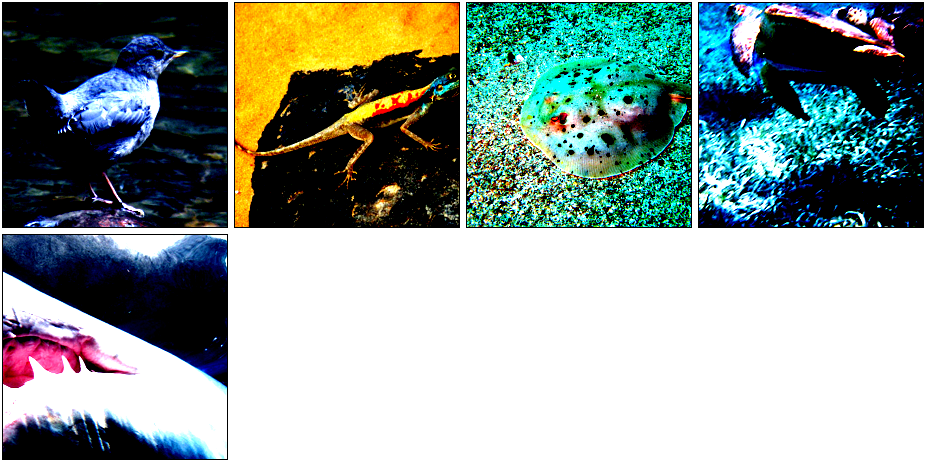

In [95]:
batch[:5].rgb

  0%|          | 0/200 [00:00<?, ?it/s]

Epsilon: 0.000700


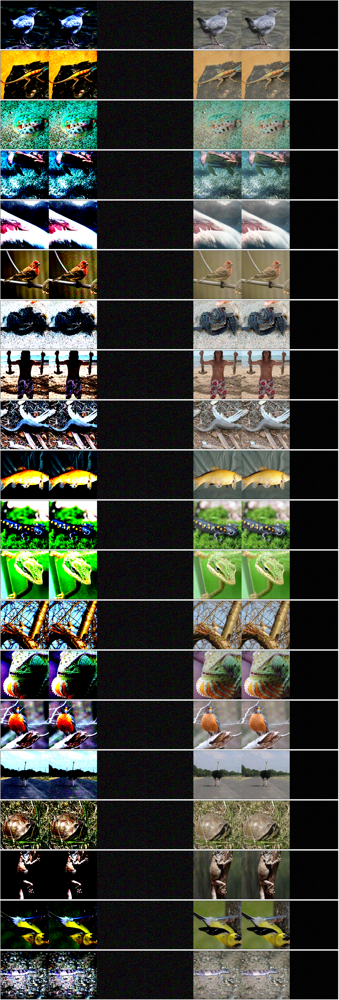

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Started class was: 20, with confidence: 0.998186
Resulted class after adversarial noise: 0, with confidence: 0.905237


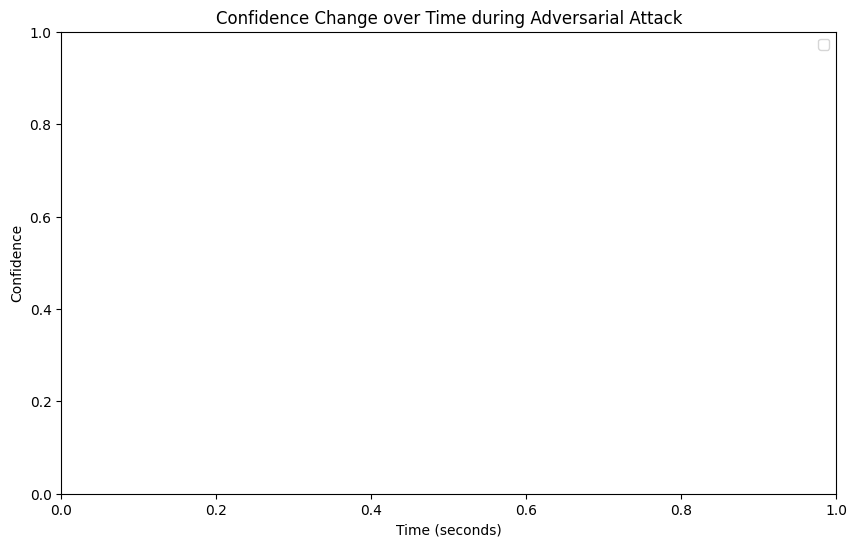

In [128]:
in_b = batch

adv_example, metrics, noise = attack(model, in_b, 0, epsilon=0.0007, num_iterations=200, lambda_reg=1000, stop_criteria=0.98)

bdiff = in_b - adv_example
adiff = adv_example - in_b

display(torch.cat([in_b, adv_example, bdiff, adiff, denorm(adv_example), denorm(in_b), denorm(adv_example) - denorm(in_b)], dim=3).rgb)

ref_class_id, ref_conf = get_class_conf(model, in_b)
print(f"Started class was: {ref_class_id}, with confidence: {ref_conf:.6f}")

res_class_id, res_conf = get_class_conf(model, adv_example)
print(f"Resulted class after adversarial noise: {res_class_id}, with confidence: {res_conf:.6f}")

plot_metrics(metrics)

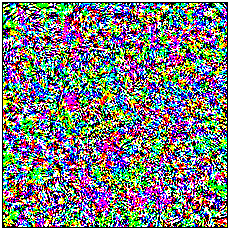

In [129]:
(noise*20).rgb

Started class was: 5, with confidence: 0.621575
Resulted class after adversarial noise: 0, with confidence: 0.734354


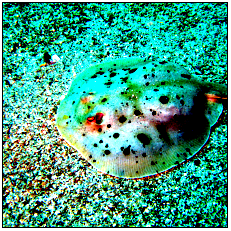

In [137]:
i = 2
image = Image.open(images_dir.ls()[i])
in_b = transform(image).unsqueeze(0).to(device)

ref_class_id, ref_conf = get_class_conf(model, in_b)
print(f"Started class was: {ref_class_id}, with confidence: {ref_conf:.6f}")

res_class_id, res_conf = get_class_conf(model, in_b + noise)
print(f"Resulted class after adversarial noise: {res_class_id}, with confidence: {res_conf:.6f}")

in_b.rgb